In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from glob import glob 

import librosa
import torchaudio
import librosa.display
import IPython.display as ipd

In [2]:
from itertools import cycle


sns.set_theme(style="white", palette=None)
color_pal = plt.rcParams["axes.prop_cycle"].by_key()["color"]
color_cycle = cycle(color_pal)

In [3]:
mp3_files = glob('/home/linagora/stt-end2end-expes/test_audios/*')

In [4]:
ipd.Audio(mp3_files[0])

In [5]:
y, sr = librosa.load(mp3_files[0])
print(f'Y: {y[:10]}')
print(f'Size Y: {y.size}')
print(f'Shape y: {y.shape}')
print(f'sr: {sr}')

Y: [-3.8463094e-10 -6.4714434e-10 -1.8208096e-10 -4.8133719e-10
  2.3372990e-10  4.2909148e-10  9.4133402e-11  8.0892298e-10
  7.7463463e-10 -2.5105043e-11]
Size Y: 817085
Shape y: (817085,)
sr: 22050


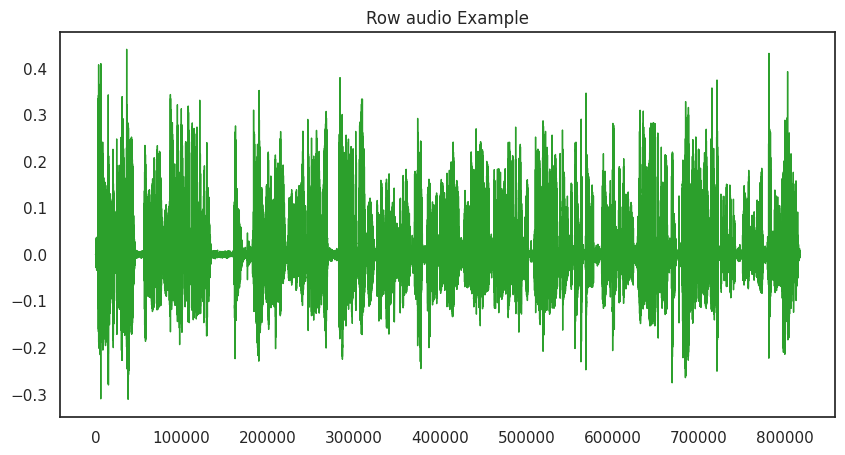

In [6]:
pd.Series(y).plot(figsize=(10, 5), lw=1, title="Row audio Example", color=color_pal[2])
plt.show()

In [7]:
ytrimmed, _ = librosa.effects.trim(y, top_db=20)

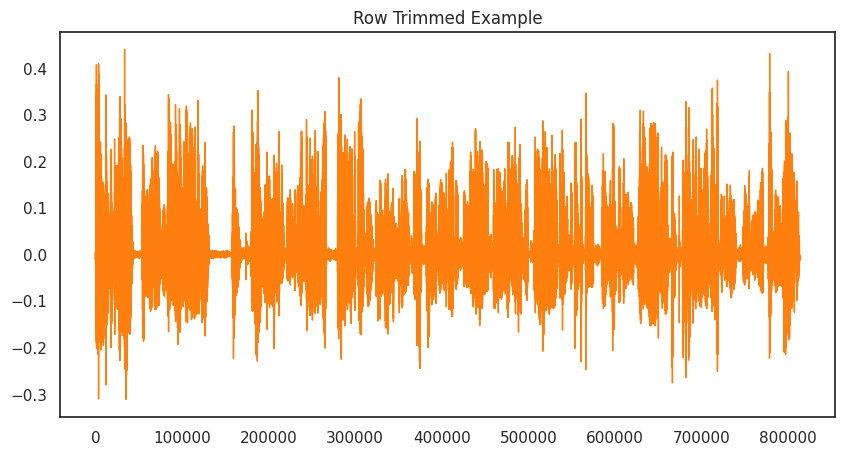

In [8]:
pd.Series(ytrimmed).plot(figsize=(10, 5), lw=1, title="Row Trimmed Example", color=color_pal[1])
plt.show()

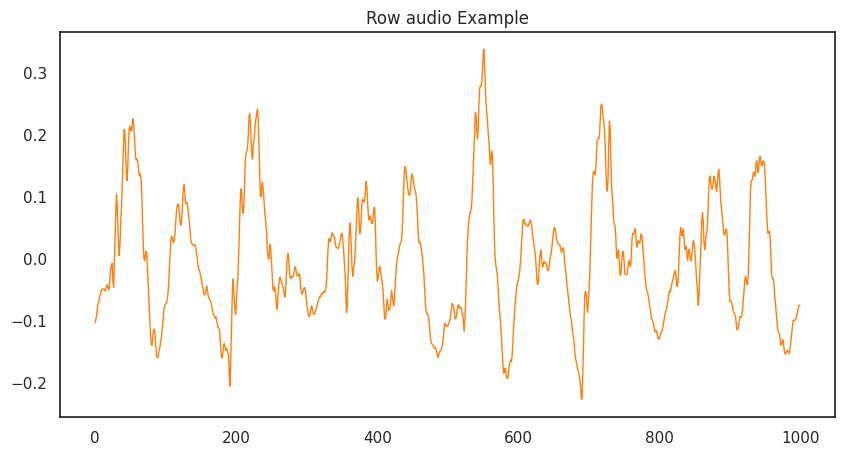

In [9]:
pd.Series(y[30000:31000]).plot(figsize=(10, 5), lw=1, title="Row audio Example", color=color_pal[1])
plt.show()

In [10]:
D = librosa.stft(y)
s_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)
s_db.shape

(1025, 1596)

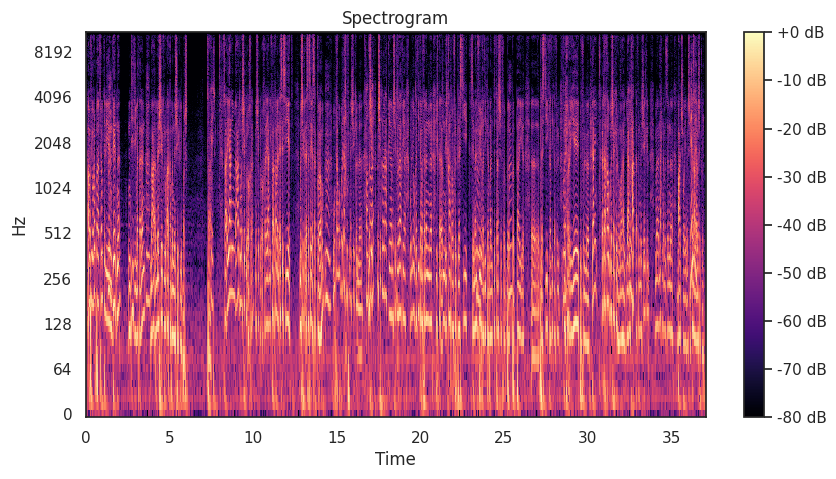

In [11]:
fig, ax = plt.subplots(figsize=(10, 5))  # Use plt.subplots instead of plt.subplot
img = librosa.display.specshow(s_db,
                               x_axis='time',
                               y_axis='log',
                               ax=ax)

# Add title and colorbar
ax.set_title('Spectrogram')
fig.colorbar(img, ax=ax, format="%+2.0f dB")

# Display the plot
plt.show()

In [12]:
S = librosa.feature.melspectrogram(y=y,sr=sr,n_mels=128)
S_db_mel = librosa.amplitude_to_db(S, ref=np.max)

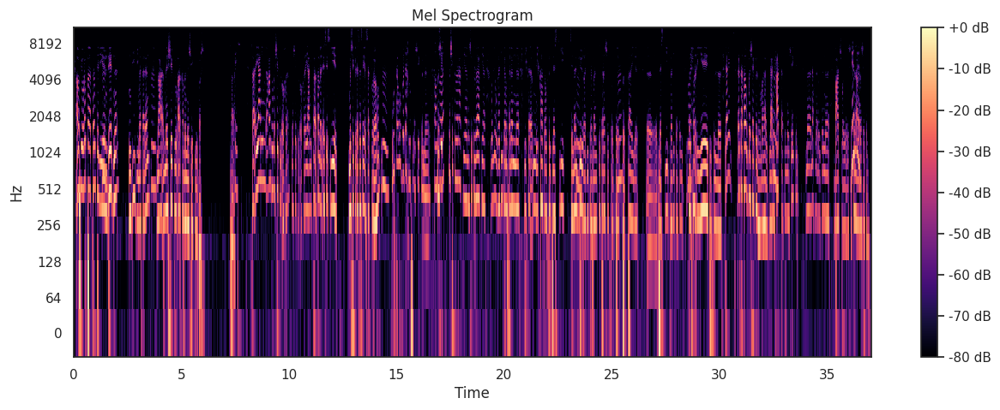

In [13]:
fig, ax = plt.subplots(figsize=(15, 5))  # Use plt.subplots instead of plt.subplot
img = librosa.display.specshow(S_db_mel,
                               x_axis='time',
                               y_axis='log',
                               ax=ax)

# Add title and colorbar
ax.set_title('Mel Spectrogram')
fig.colorbar(img, ax=ax, format="%+2.0f dB")

# Display the plot
plt.show()

In [16]:
import sounddevice as sd
y, sr = librosa.load(mp3_files[0], sr=None)
# This is mono playback, stereo is a bit trickier
sd.play(y, sr)
sd.wait()


In [56]:
from IPython.display import Audio
import librosa
import matplotlib.pyplot as plt
import torch
import torchaudio.transforms as T


In [28]:
torch.random.manual_seed(0)

In [57]:
def plot_waveform(waveform, sr, title="Waveform"):
    waveform = waveform.numpy()

    num_channels, num_frames = waveform.shape
    time_axis = torch.arange(0, num_frames) / sr

    figure, axes = plt.subplots(num_channels, 1, figsize=(10, 4 * num_channels))  # Adjust figure size
    for channel in range(num_channels):
        axes[channel].plot(time_axis, waveform[channel], linewidth=1)  # Plot the waveform data
        axes[channel].grid(True)
        axes[channel].set_ylabel(f"Channel {channel}")
    figure.suptitle(title)
    plt.show(block=False)


def plot_spectrogram(specgram, title=None, ylabel="freq_bin"):
    fig, axs = plt.subplots(1, 1)
    axs.set_title(title or "Spectrogram (db)")
    axs.set_ylabel(ylabel)
    axs.set_xlabel("frame")
    im = axs.imshow(librosa.power_to_db(specgram), origin="lower", aspect="auto")
    fig.colorbar(im, ax=axs)
    plt.show(block=False)


def plot_fbank(fbank, title=None):
    fig, axs = plt.subplots(1, 1)
    axs.set_title(title or "Filter bank")
    axs.imshow(fbank, aspect="auto")
    axs.set_ylabel("frequency bin")
    axs.set_xlabel("mel bin")
    plt.show(block=False)

In [36]:
SPEECH_WAVEFORM, SAMPLE_RATE = torchaudio.load(mp3_files[1])

Audio(SPEECH_WAVEFORM.numpy(), rate=SAMPLE_RATE)

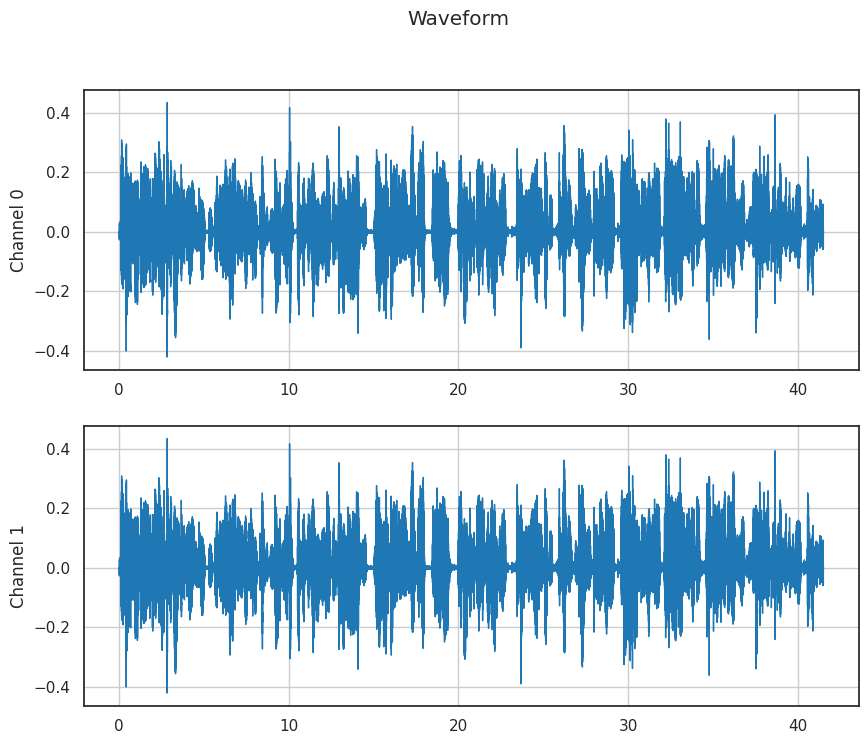

In [58]:
plot_waveform(SPEECH_WAVEFORM, SAMPLE_RATE)

In [43]:
n_fft = 1024
win_length = None
hop_length = 512

# Define transform
spectrogram = T.Spectrogram(
    n_fft=n_fft,
    win_length=win_length,
    hop_length=hop_length,
    center=True,
    pad_mode="reflect",
    power=2.0,
)

In [53]:
spec = spectrogram(SPEECH_WAVEFORM)
spec.shape

torch.Size([2, 513, 3891])

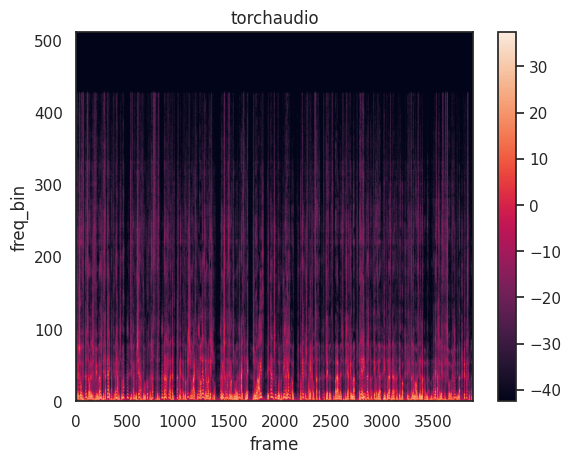

In [54]:
plot_spectrogram(spec[0], title="torchaudio")


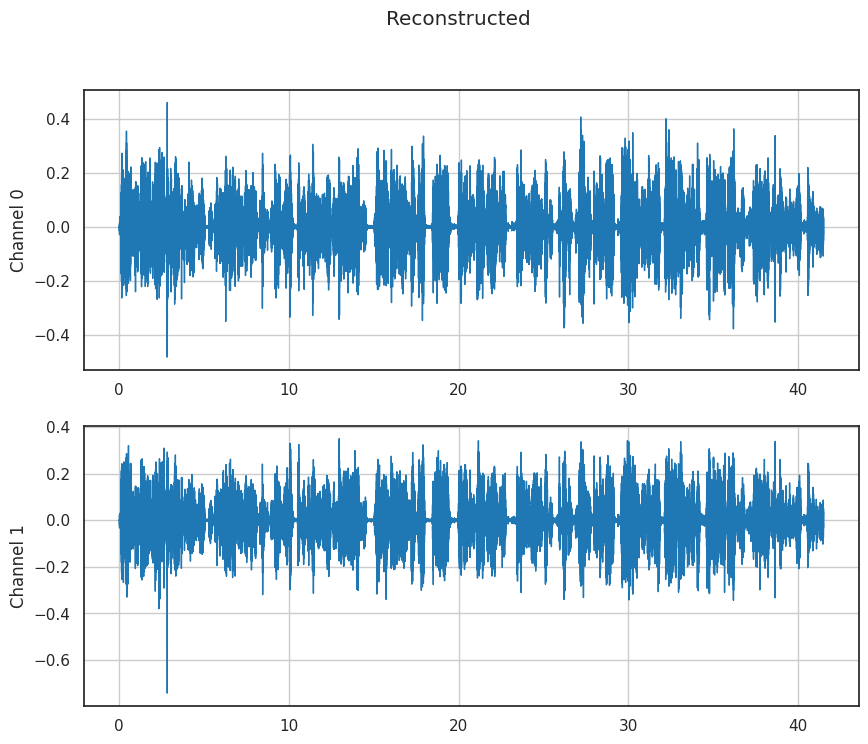

In [59]:
torch.random.manual_seed(0)

n_fft = 1024
win_length = None
hop_length = 512

spec = T.Spectrogram(
    n_fft=n_fft,
    win_length=win_length,
    hop_length=hop_length,
)(SPEECH_WAVEFORM)
griffin_lim = T.GriffinLim(
    n_fft=n_fft,
    win_length=win_length,
    hop_length=hop_length,
)
reconstructed_waveform = griffin_lim(spec)
plot_waveform(reconstructed_waveform, SAMPLE_RATE, title="Reconstructed")
Audio(reconstructed_waveform, rate=SAMPLE_RATE)

/home/linagora/.local/lib/python3.9/site-packages/torchaudio/transforms/_transforms.py:611: UserWarning: Argument 'onesided' has been deprecated and has no influence on the behavior of this module.
  warnings.warn(
/home/linagora/.local/lib/python3.9/site-packages/torchaudio/functional/functional.py:576: UserWarning: At least one mel filterbank has all zero values. The value for `n_mels` (128) may be set too high. Or, the value for `n_freqs` (513) may be set too low.
  warnings.warn(


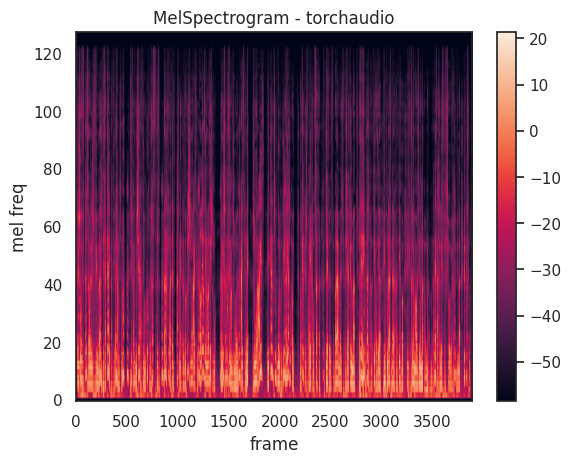

In [60]:
n_fft = 1024
win_length = None
hop_length = 512
n_mels = 128

mel_spectrogram = T.MelSpectrogram(
    sample_rate=SAMPLE_RATE,
    n_fft=n_fft,
    win_length=win_length,
    hop_length=hop_length,
    center=True,
    pad_mode="reflect",
    power=2.0,
    norm="slaney",
    onesided=True,
    n_mels=n_mels,
    mel_scale="htk",
)

melspec = mel_spectrogram(SPEECH_WAVEFORM)
plot_spectrogram(melspec[0], title="MelSpectrogram - torchaudio", ylabel="mel freq")


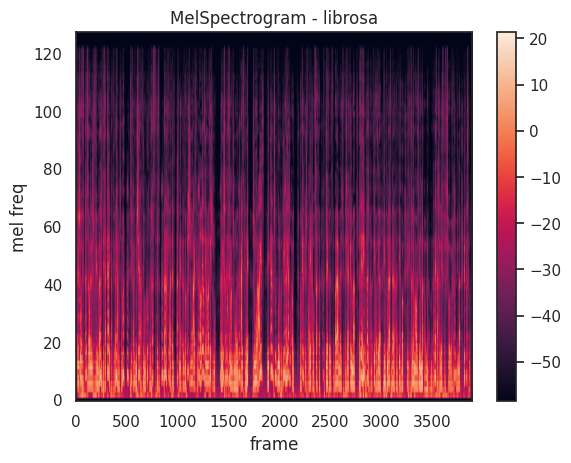

Mean Square Difference:  8.780619828030467e-05


In [61]:
melspec_librosa = librosa.feature.melspectrogram(
    y=SPEECH_WAVEFORM.numpy()[0],
    sr=SAMPLE_RATE,
    n_fft=n_fft,
    hop_length=hop_length,
    win_length=win_length,
    center=True,
    pad_mode="reflect",
    power=2.0,
    n_mels=n_mels,
    norm="slaney",
    htk=True,
)
plot_spectrogram(melspec_librosa, title="MelSpectrogram - librosa", ylabel="mel freq")

mse = torch.square(melspec - melspec_librosa).mean().item()
print("Mean Square Difference: ", mse)

/home/linagora/.local/lib/python3.9/site-packages/torchaudio/functional/functional.py:576: UserWarning: At least one mel filterbank has all zero values. The value for `n_mels` (256) may be set too high. Or, the value for `n_freqs` (1025) may be set too low.
  warnings.warn(


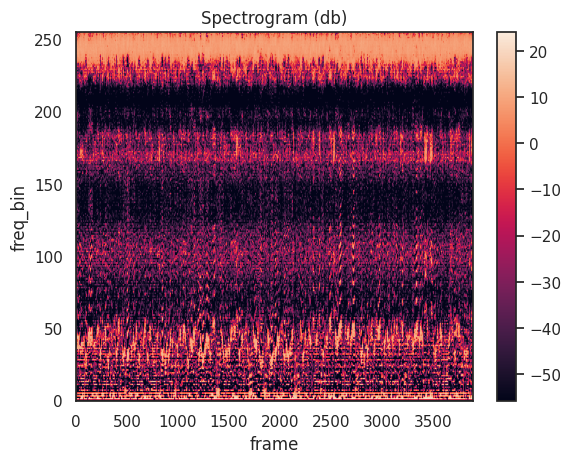

In [63]:
n_fft = 2048
win_length = None
hop_length = 512
n_mels = 256
n_mfcc = 256

mfcc_transform = T.MFCC(
    sample_rate=SAMPLE_RATE,
    n_mfcc=n_mfcc,
    melkwargs={
        "n_fft": n_fft,
        "n_mels": n_mels,
        "hop_length": hop_length,
        "mel_scale": "htk",
    },
)

mfcc = mfcc_transform(SPEECH_WAVEFORM)
plot_spectrogram(mfcc[0])

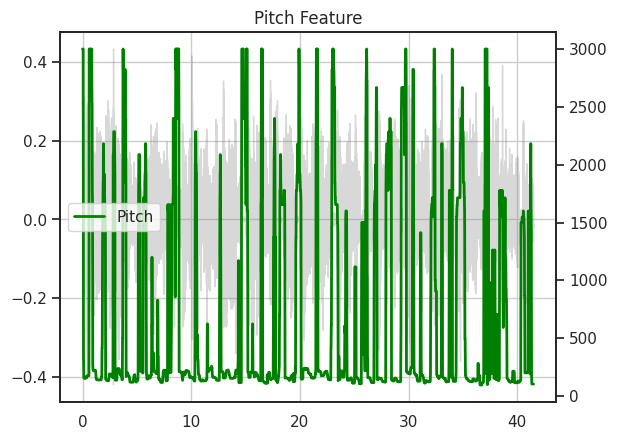

In [65]:
import torchaudio.functional as F
pitch = F.detect_pitch_frequency(SPEECH_WAVEFORM, SAMPLE_RATE)
def plot_pitch(waveform, sr, pitch):
    figure, axis = plt.subplots(1, 1)
    axis.set_title("Pitch Feature")
    axis.grid(True)

    end_time = waveform.shape[1] / sr
    time_axis = torch.linspace(0, end_time, waveform.shape[1])
    axis.plot(time_axis, waveform[0], linewidth=1, color="gray", alpha=0.3)

    axis2 = axis.twinx()
    time_axis = torch.linspace(0, end_time, pitch.shape[1])
    axis2.plot(time_axis, pitch[0], linewidth=2, label="Pitch", color="green")

    axis2.legend(loc=0)
    plt.show(block=False)


plot_pitch(SPEECH_WAVEFORM, SAMPLE_RATE, pitch)

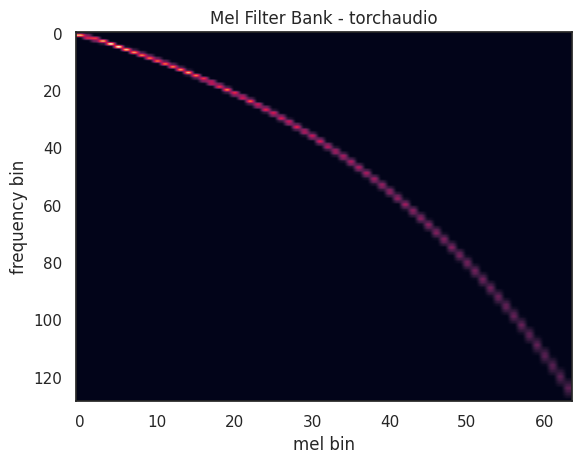

In [66]:
n_fft = 256
n_mels = 64
sample_rate = 6000

mel_filters = F.melscale_fbanks(
    int(n_fft // 2 + 1),
    n_mels=n_mels,
    f_min=0.0,
    f_max=sample_rate / 2.0,
    sample_rate=sample_rate,
    norm="slaney",
)
plot_fbank(mel_filters, "Mel Filter Bank - torchaudio")